In [1]:
import json
import pandas as pd
import matplotlib.pyplot as plt
import re
import collections
from os import listdir
from os.path import isfile, join
from pprint import pprint

In [40]:
def get_graphs(file_path, show_gamma=False, save_figure=False):
    with open(file_path) as f:
        res = json.load(f)
    gans_index = ["wgan", "wgpgan", "nsgan", "lsgan", "mmgan", "nsgan", "began", 'dragan']
    distance_metrics = ["KL-Divergence", "Jensen-Shannon", "Wasserstein-Distance", "Energy-Distance", "GLoss", "DLoss"]
#     distance_metrics = ["Wasserstein-Distance"]
#     distance_metrics = ["KL-Divergence"]
    for gan in gans_index:
        normal = pd.DataFrame(res[gan]['normal'])
        beta = pd.DataFrame(res[gan]['beta'])
        exponential = pd.DataFrame(res[gan]['exponential'])
        gamma = pd.DataFrame(res[gan]['gamma'])
        gumbel = pd.DataFrame(res[gan]['gumbel'])
        for dist in distance_metrics:
            plt.plot(range(len(normal[dist])), normal[dist], label="Normal")
            plt.plot(range(len(normal[dist])), beta[dist], label="Beta")
            plt.plot(range(len(normal[dist])), exponential[dist], label="Exponential")
            if show_gamma is True:
                plt.plot(range(len(normal[dist])), gamma[dist], label="Gamma")
            plt.plot(range(len(normal[dist])), gumbel[dist], label="Gumbel")
            plt.xlabel("Epoch")
            plt.ylabel(dist)
            plt.title("{2}: {0} on {1}".format(gan.upper(), dist, re.sub("hypertuning/", "", file_path)))
            plt.legend()
            plt.show()
            if save_figure is True:
                plt.savefig('graphs/{0}_{1}.png'.format(gan, dist), dpi=100)
            plt.clf()

In [32]:
onlyfiles = [f for f in listdir('hypertuning') if isfile(join('hypertuning', f))]
file_paths = ['hypertuning/' + i for i in  onlyfiles]
kl = []
d1_a = []
d1_b = []
d1_c = []
d1_d = []
d1_e = []
d1_f = []
d2 = []
d3 = []
d4 = []
for file_path in file_paths:
    with open(file_path) as f:
        data = json.load(f)
        for k, v in data.items():
            kl = []
            js = []
            wd = []
            ed = []
            for k2, v2 in v.items():
                d1_a.append(min(v2["KL-Divergence"]))
                d1_b.append(min(v2["Jensen-Shannon"]))
                d1_c.append(min(v2["Wasserstein-Distance"]))
                d1_d.append(min(v2["Energy-Distance"]))
                d1_e.append(min(v2["DLoss"]))
                d1_f.append(min(v2["GLoss"]))
                d2.append(file_path)
                d3.append(k)
                d4.append(k2)
df = pd.DataFrame({"kl": d1_a, "js": d1_b, "wd": d1_c, "ed": d1_d, 'dloss': d1_e, 'gloss': d1_f,"hyperparameter": d2, "gan": d3, "distribution": d4})

In [39]:
min(df.gloss)
max(df.gloss)
min(df.dloss)
# max(df.dloss)

-308179.34375

In [33]:
gans_index = ["wgan", "wgpgan", "nsgan", "lsgan", "mmgan", "nsgan", "began", 'dragan']
distribution = ['beta', 'exponential', 'gamma', 'gumbel']
best = []
parameters = []
for i in gans_index:
    for d in distribution:
        print("{0} | {1} | {2}".format(i, d, df[df.kl==df[(df.gan==i) & (df.distribution==d)].kl.min()].hyperparameter.values[0]))
        best.append(df[df.kl==df[(df.gan==i) & (df.distribution==d)].kl.min()].hyperparameter.values[0])

wgan | beta | hypertuning/data(0.001, 32, 250).json
wgan | exponential | hypertuning/data(0.001, 16, 250).json
wgan | gamma | hypertuning/data(0.0001, 128, 100).json
wgan | gumbel | hypertuning/data(0.0005, 16, 150).json
wgpgan | beta | hypertuning/data(0.001, 256, 100).json
wgpgan | exponential | hypertuning/data(0.001, 256, 250).json
wgpgan | gamma | hypertuning/data(0.0001, 256, 250).json
wgpgan | gumbel | hypertuning/data(0.001, 16, 250).json
nsgan | beta | hypertuning/data(0.001, 128, 100).json
nsgan | exponential | hypertuning/data(0.001, 256, 250).json
nsgan | gamma | hypertuning/data(0.0001, 256, 250).json
nsgan | gumbel | hypertuning/data(0.001, 128, 250).json
lsgan | beta | hypertuning/data(0.001, 256, 200).json
lsgan | exponential | hypertuning/data(0.001, 256, 250).json
lsgan | gamma | hypertuning/data(0.0005, 256, 250).json
lsgan | gumbel | hypertuning/data(0.0005, 256, 250).json
mmgan | beta | hypertuning/data(0.001, 256, 100).json
mmgan | exponential | hypertuning/data(0

In [24]:
counter=collections.Counter(best)
counter

Counter({'hypertuning/data(0.0001, 128, 100).json': 1,
         'hypertuning/data(0.0001, 128, 250).json': 1,
         'hypertuning/data(0.0001, 16, 250).json': 1,
         'hypertuning/data(0.0001, 256, 250).json': 4,
         'hypertuning/data(0.0005, 128, 250).json': 1,
         'hypertuning/data(0.0005, 16, 150).json': 1,
         'hypertuning/data(0.0005, 256, 250).json': 3,
         'hypertuning/data(0.001, 128, 100).json': 2,
         'hypertuning/data(0.001, 128, 200).json': 1,
         'hypertuning/data(0.001, 128, 250).json': 2,
         'hypertuning/data(0.001, 16, 250).json': 3,
         'hypertuning/data(0.001, 256, 100).json': 2,
         'hypertuning/data(0.001, 256, 150).json': 1,
         'hypertuning/data(0.001, 256, 200).json': 1,
         'hypertuning/data(0.001, 256, 250).json': 5,
         'hypertuning/data(0.001, 32, 100).json': 1,
         'hypertuning/data(0.001, 32, 250).json': 1,
         'hypertuning/data(0.001, 64, 100).json': 1})

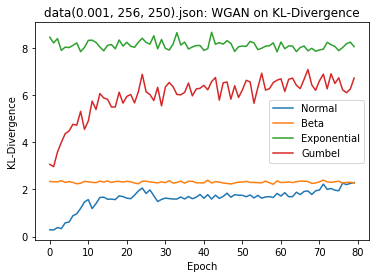

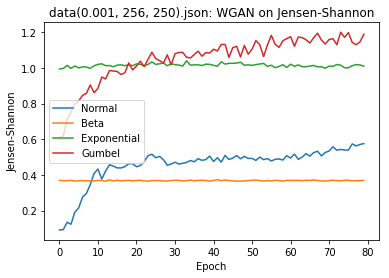

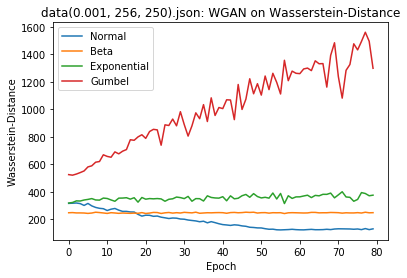

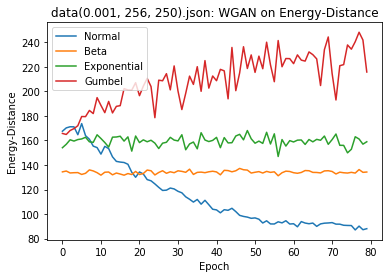

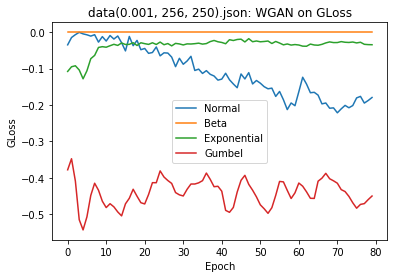

...

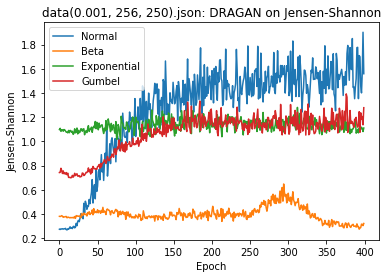

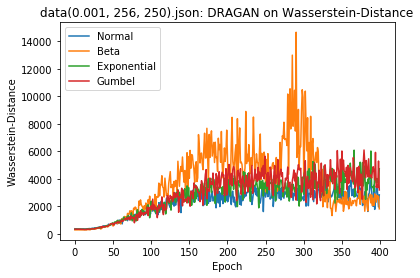

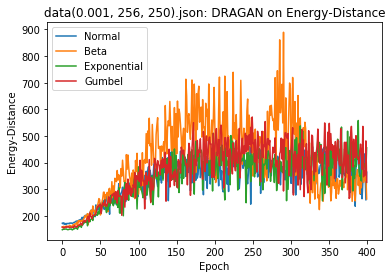

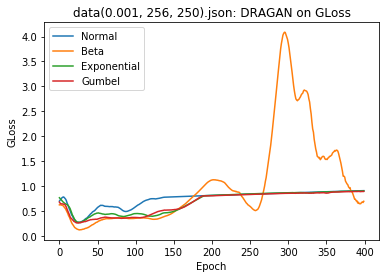

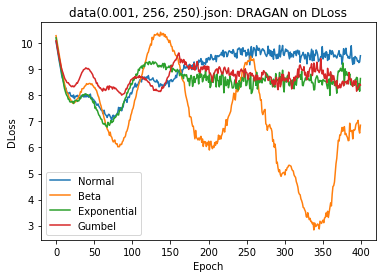

In [41]:
get_graphs('hypertuning/data(0.001, 256, 250).json')

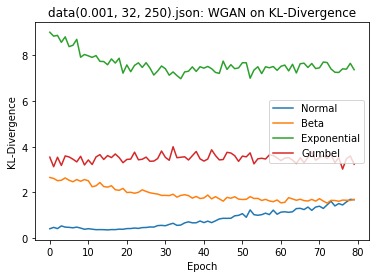

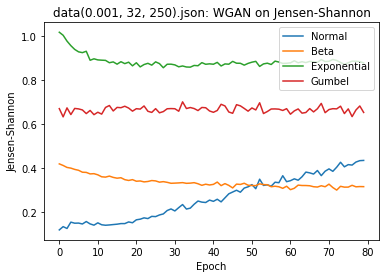

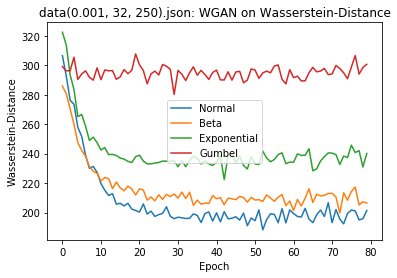

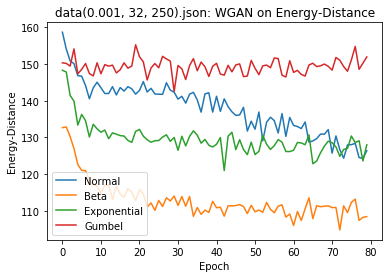

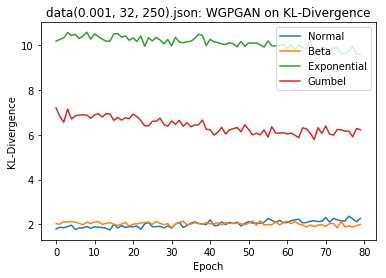

...

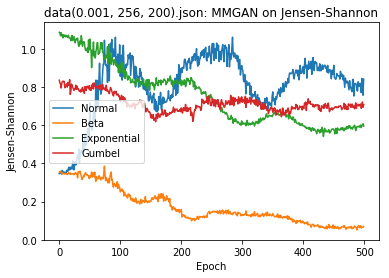

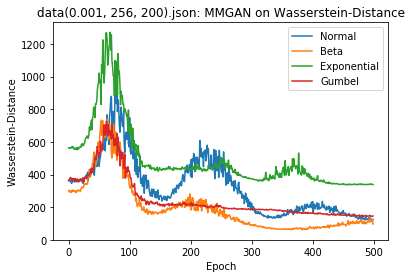

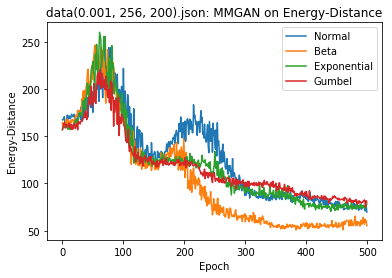

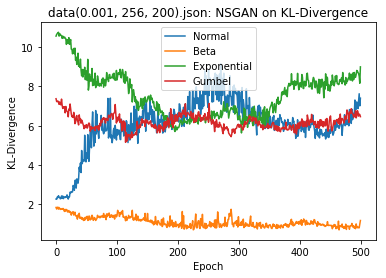

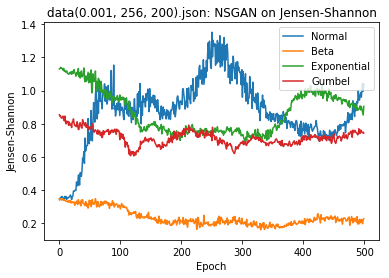

KeyboardInterrupt: 

In [7]:
# for i in best:
#     get_graphs(i)

In [26]:
with open('mnistgoodies.json') as f:
    data = json.load(f)

In [27]:
data.keys()

dict_keys(['wgan', 'wgpgan', 'nsgan', 'lsgan', 'mmgan', 'dragan', 'began'])

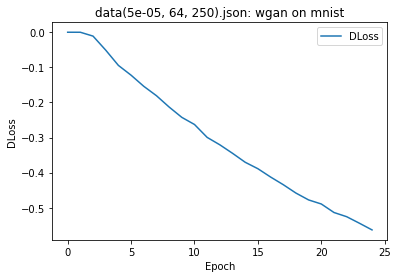

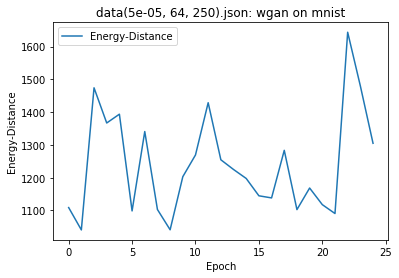

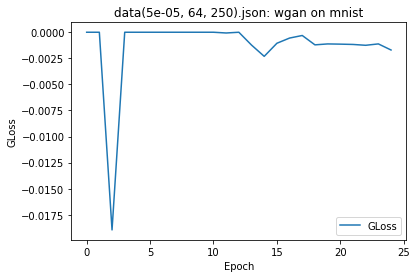

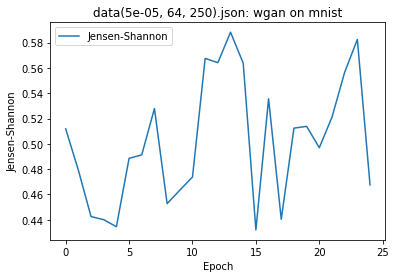

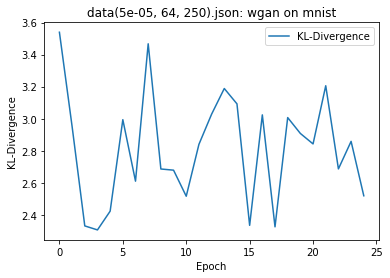

...

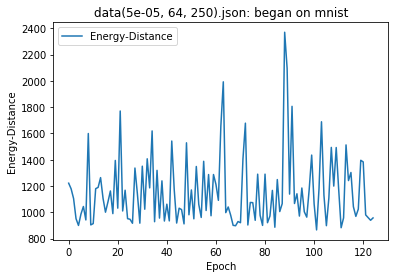

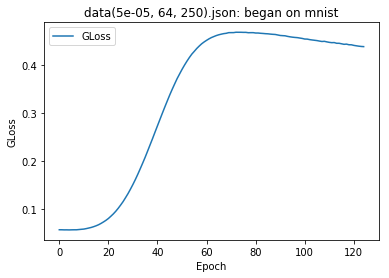

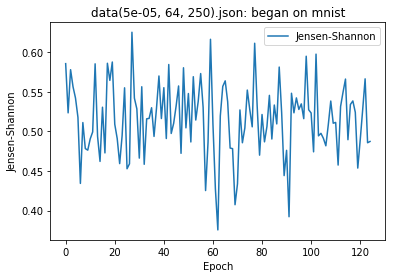

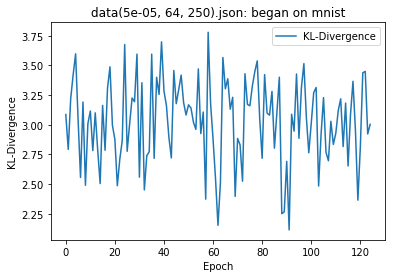

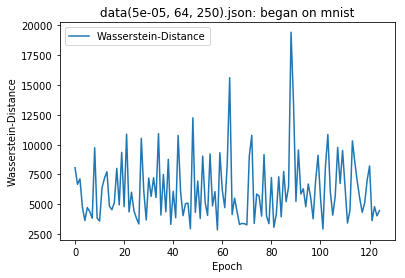

In [28]:
for key in data.keys():
    mnist = pd.DataFrame(data[key]['mnist'])
    for i in mnist.columns:
        plt.plot(range(len(mnist[i])), mnist[i])
        plt.xlabel("Epoch")
        plt.ylabel(i)
        plt.title("{2}: {0} on {1}".format(key, 'mnist', re.sub("hypertuning/", "", file_path)))
        plt.legend()
        plt.show()
        plt.clf()